# Formalia:

Please read the [assignment overview page](https://github.com/suneman/socialgraphs2019/wiki/Assignments) carefully before proceeding. This page contains information about formatting (including formats etc), group sizes, and many other aspects of handing in the assignment. 

*If you fail to follow these simple instructions, it will negatively impact your grade!*

**Due date and time**: The assignment is due on Tuesday November 5th at 23:55. Hand in your IPython notebook file (with extension `.ipynb`) via http://peergrade.io/.

# Part 1: Twitter Network Analysis

_Exercise_ 1: Build the network of retweets.
We will now build a network that has as nodes the Twitter handles of the members of the house, and direct edges between nodes A and B if A has retweeted content posted by B. We will build a weighted network, where the weight of an edge is equal to the number of retweets. You can build the network following the steps below (and you should  be able to reuse many of the functions you have written as part of the exercises during the previous weeks):

* Consider the 200 most recent tweets written by each member of the house (use the files [here](https://github.com/suneman/socialgraphs2019/tree/master/files/data_twitter/tweets_2019.zip/). For each file, use a regular expression to find retweets and to extract the Twitter handle of the user whose content was retweeted. All retweets begin with "*RT @originalAuthor:*", where "*originalAuthor*" is the handle of the user whose content was retweeted (and the part of the text you want to extract).

In [1]:
# Load the necessary packages

import matplotlib.pyplot as plt
import numpy as np
import sys, os, re
import pandas as pd
import networkx as nx

In [3]:
# Load first the data

path = "./tweets_2019_full"

retweet_dict = {}

for file in os.listdir(path):
    name = file
    persons_tweets = open(path + '/' + file, encoding= 'utf-8').read()
    handles = re.findall("RT\s\@\w+\:", persons_tweets)
    handle_list = []
    for handle in handles:
        handle_list.append(handle.split("@")[1].split(":")[0])
    retweet_dict[file] = handle_list

#### For each retweet, check if the handle retweeted is, in fact, the handle of a member of the house. If yes, keep it. If no, discard it.

In [116]:
h115_tw = pd.read_csv("H115_tw_2019.csv")

tw_handles = list(h115_tw['tw_name']) # Find the twitter handles to compare

for politician in retweet_dict.keys():
    politician_retweets = retweet_dict[politician]
    house_retweets = []
    for OGAuthor in politician_retweets:
        if OGAuthor in tw_handles:
            house_retweets.append(OGAuthor)
    retweet_dict[politician] = house_retweets  # Update the dictionary such that it only contains the handles of house members

#### Use a NetworkX [`DiGraph`](https://networkx.github.io/documentation/development/reference/classes.digraph.html) to store the network. Use weighted edges to account for multiple retweets. Also store the party of each member as a node attribute (use the data in [this file](https://github.com/suneman/socialgraphs2019/blob/master/files/data_twitter/H115_tw_2019.csv). Remove self-loops (edges that connect a node with itself).

In [117]:
twitter_graph = nx.DiGraph()

for idx, person in enumerate(list(h115_tw['Name'])):
    twitter_graph.add_node(person, party = h115_tw['Party'][idx])

edge_dict = {}
for member in retweet_dict.keys():
    member_real_name = h115_tw[h115_tw['WikiPageName'] == member].values[0][3] # Get the real name of the meber
    for link in retweet_dict[member]:
        link_real_name = h115_tw[h115_tw['tw_name'] == link].values[0][3]      # Get the real name of the retweeted user
        if link_real_name == member_real_name: # skips self-loops
            continue
        else:
            # Check if we have already seen this link before
            if (member_real_name, link_real_name) in edge_dict.keys():
                edge_dict[(member_real_name, link_real_name)] += 1     # Increment if seen
            else:
                edge_dict[(member_real_name, link_real_name)] = 1      # Add this link in the dictionary 

# Add the edges
for pair in edge_dict:
    twitter_graph.add_edge(pair[0], pair[1], weight = edge_dict[pair])

 ## _Exercise_ 2: Visualize the network of retweets and investigate differences between the parties.
 * Visualize the network using the [Networkx draw function](https://networkx.github.io/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw.html#networkx.drawing.nx_pylab.draw), and nodes coordinates from the force atlas algorithm. *Hint: use an undirected version of the graph to find the nodes positions for better results, but stick to the directed version for all measurements.* Plot nodes in colors according to their party (e.g. 'red' for republicans and 'blue' for democrats) and set the node-size to be proportional to total degree. 
 
 

100%|██████████| 400/400 [00:00<00:00, 486.46it/s]


BarnesHut Approximation  took  0.32  seconds
Repulsion forces  took  0.44  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


(-438725.34350438754, 431256.3824289479, -55141.23943172455, 54634.69118083594)

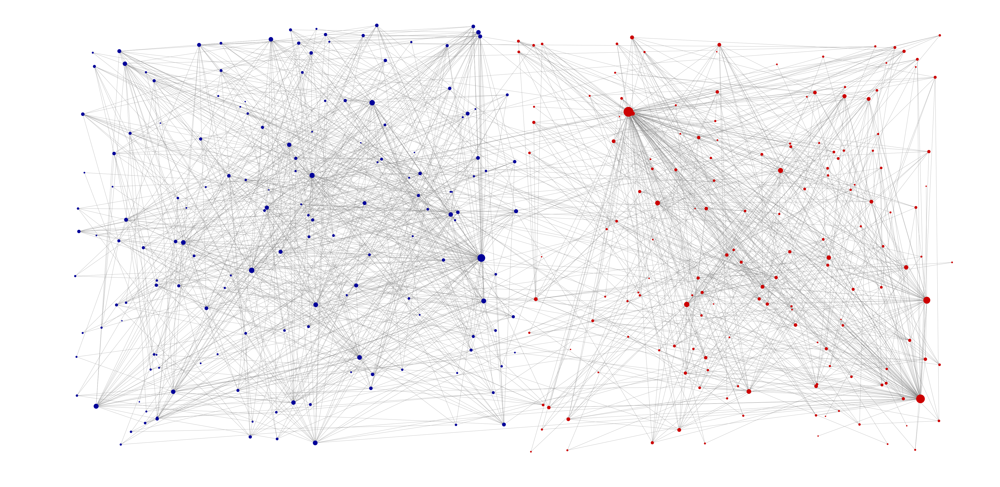

In [118]:
from fa2 import ForceAtlas2
color_map = []

for party in h115_tw['Party']:
    if party == 'Democratic':
        color_map.append('#000099')
    else:
        color_map.append('#cc0000')

undir_tw_G = nx.Graph(twitter_graph)
force_atlas2 = ForceAtlas2()
positions = force_atlas2.forceatlas2_networkx_layout(undir_tw_G, pos=None, iterations=400)

for idx, key in enumerate(positions):
    if 'Democratic' == h115_tw['Party'][idx]:
        positions[key] = (positions[key][0] - np.random.randint(100,400000), positions[key][1] + np.random.randint(-50000,50000))
    else:
        positions[key] = (positions[key][0] + np.random.randint(100,400000), positions[key][1]+ np.random.randint(-50000,50000))

plt.figure(figsize=(30,15), dpi=200)
nx.draw_networkx_nodes(undir_tw_G, pos=positions, node_color = color_map, 
                       node_size = [2*v for v in dict(twitter_graph.degree()).values()])

nx.draw_networkx_edges(undir_tw_G, pos=positions, edge_color= 'grey', width = 0.25 )
plt.axis('off')

#### Compare the network of Retweets with the network of Wikipedia pages (generated during Week 5). Do you observe any differences? How do you explain them?
 

> Lets start by showing the graph of the Wikipedia pages that was generated during Week 5. ![title](Wikipedia_Graph.PNG)
Comparing the 2 figures, we notice that the Wikipedia page graph has many more connections between the parties. This is most likely due to the fact that in twitter you share more info that is relevant to you and your causes which of course is more likely to happen from other members of the same party.

#### Now set the node-size tob proportional to betweenness centrality. Do you observe any changes?

**Answer:**
> First of all we had to scale the size of the node by a large amount (multiplied centrality with 1000) to actually be able to observe the nodes. The first thing to notice is that a lot of nodes seems to have disappeared, which is due to the fact that a lot of nodes has a betweenness centrality of 0. This means that no shortest path between two nodes passes these nodes. 

(-438725.3436447567, 431256.3822103377, -55141.23901064144, 54634.69205111488)

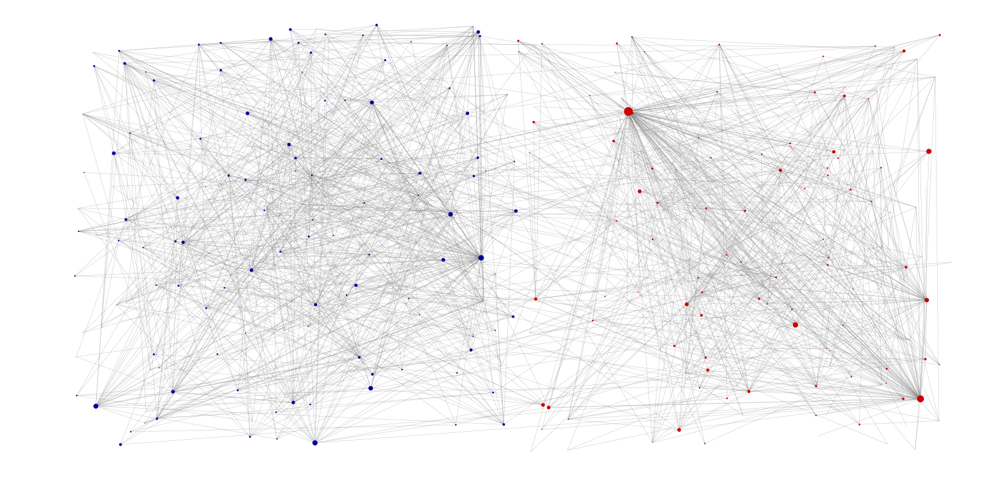

In [119]:
between_centrality = nx.algorithms.centrality.betweenness_centrality(twitter_graph)

plt.figure(figsize=(30,15))
nx.draw_networkx_nodes(undir_tw_G, pos=positions, node_color = color_map, 
                       node_size = [1000*v for v in between_centrality.values()])

nx.draw_networkx_edges(undir_tw_G, pos=positions, edge_color= 'grey', width = 0.25 )
plt.axis('off')

#### Repeat the point above using eigenvector centrality. Again, do you see a difference? Can you explain why based on what eigenvector centrality measures?

**Answer**
> Again we notice a huge difference. First of all, all the nodes of the democratic party members seems to have disappeared or appear very small. To explain this, we must remind ourselves what the eigenvector centrality measures. The eigenvector centrality reads "_A node is important if it is linked to by other important nodes._" Looking at the first graph, we notice that a lot of the large republican nodes (they're large because they have a high degree in this case) links to other small degree nodes. The large nodes also seems to connect to other large nodes as well. This is not the case for the democratic party members as most hubs just connect to small unimportant nodes. That is why the small nodes in the first graph becomes more important in the eigenvector centrality graph for the republican nodes. Essentially this means that the important figures in the republican party tends to retweet more the less important persons in the party.

(-438725.34351390443,
 431256.38257216534,
 -55141.243075128725,
 54634.69275181919)

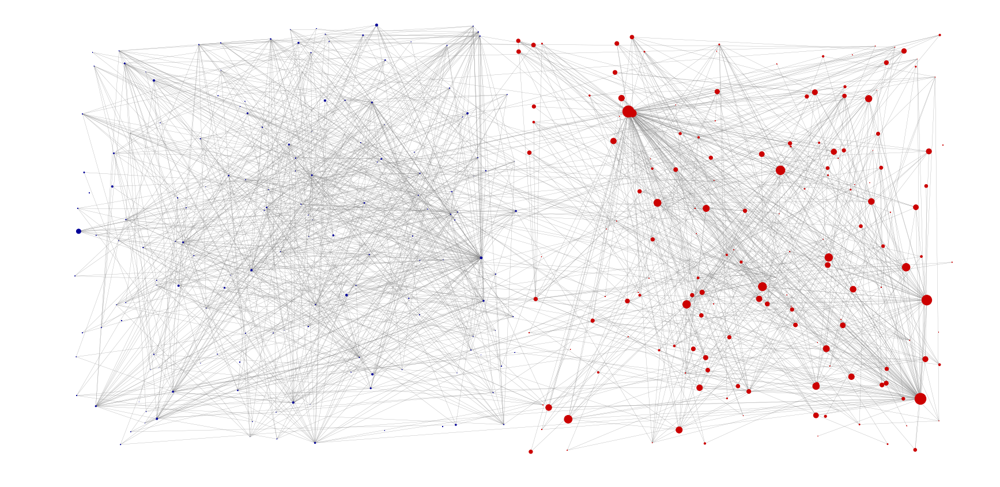

In [120]:
eigen_centrality = nx.algorithms.centrality.eigenvector_centrality(twitter_graph)

plt.figure(figsize=(30,15))
nx.draw_networkx_nodes(undir_tw_G, pos=positions, node_color = color_map, 
                       node_size = [1000*v for v in eigen_centrality.values()])

nx.draw_networkx_edges(undir_tw_G, pos=positions, edge_color= 'grey', width = 0.25 )
plt.axis('off')

#### Who are the three nodes with highest degree within each party? And what is their eigenvector centrality? And their betweenness centrality?


In [123]:
# Define the variables to store the information about which members are republican and democrats respectively. 
rep_members = []
dem_members = []

# Find out which member belongs to which party and store it
for key in h115_tw['Name']:
    if h115_tw[h115_tw['Name'] == key]['Party'].item() == 'Republican':
        rep_members.append(key)
    else:
        dem_members.append(key)

highest_n = 3
# Find the top 3 highest degree nodes in each party
top3_deg_dem = sorted(dict(twitter_graph.degree(dem_members)).items(), key=lambda x: x[1], reverse=True)[:highest_n]
top3_deg_rep = sorted(dict(twitter_graph.degree(rep_members)).items(), key=lambda x: x[1], reverse=True)[:highest_n]

print(f'Top {highest_n} highest degree nodes from the Democratic Party and their centrality measures\n')

for i in range(0, highest_n):
    current_name, degree = top3_deg_dem[-(i+1)]
    print(f'The {highest_n-i} highest degree node: {current_name} with degree {degree}, Eigenvector Centrality = {round(eigen_centrality[current_name], 5)}, Betweenness Centrality = {round(between_centrality[current_name], 5)}')

print()
print(f'Top {highest_n} highest degree nodes from the Republican Party and their centrality measures\n')

for i in range(0, highest_n):
    current_name, degree = top3_deg_rep[-(i+1)]
    print(f'The {highest_n-i} highest degree node: {current_name} with degree {degree}, Eigenvector Centrality = {round(eigen_centrality[current_name], 5)}, Betweenness Centrality = {round(between_centrality[current_name], 5)}')

Top 3 highest degree nodes from the Democratic Party and their centrality measures

The 3 highest degree node: Linda Sánchez with degree 35, Eigenvector Centrality = 0.00382, Betweenness Centrality = 0.03343
The 2 highest degree node: Raúl Grijalva with degree 35, Eigenvector Centrality = 0.00979, Betweenness Centrality = 0.02532
The 1 highest degree node: Nancy Pelosi with degree 76, Eigenvector Centrality = 0.01364, Betweenness Centrality = 0.06985

Top 3 highest degree nodes from the Republican Party and their centrality measures

The 3 highest degree node: Andy Biggs with degree 61, Eigenvector Centrality = 0.3001, Betweenness Centrality = 0.04389
The 2 highest degree node: Steve Scalise with degree 99, Eigenvector Centrality = 0.37945, Betweenness Centrality = 0.12279
The 1 highest degree node: Kevin McCarthy with degree 128, Eigenvector Centrality = 0.38962, Betweenness Centrality = 0.20013


#### Plot (on the same figure) the distribution of outgoing strength for the republican and democratic nodes repectively (i.e. the sum of the weight on outgoing links). Which party is more active in retweeting other members of the house?

**Answer**
>Looking at the generated bar plot below it appears that the republican party is better to retweet other members of the house. Looking at the total retweets each party has done, it seems that the republicans have 43% more total retweets done. Also looking how at the numbers that represents how many nodes each party have for that given out-degree, we notice that the republicans are much better at retweeting as in the some cases, both parties have (almost) the number of nodes for a specific out-degree but the republicans are tweeting much more than their democratic counterparts. F.x. the red bar at degree 19 represents a single person who has an out-degree of 19 but this person has retweeted more than its 3 blue neighbor columns of similar out-degree, COMBINED and doubled that.

In [128]:
# Count the freqeuncies of how many has degree 0, degree 1 etc. for both parties. 
# Keys are the degree and values are the freq
out_deg_rep = {}
for rep in rep_members:
    rep_links = dict(twitter_graph[rep]) # Get the links of the rep member
    out_deg = twitter_graph.out_degree(rep)
    if out_deg == 0:
        continue
    edge_w = 0
    for link in rep_links:
        edge_w += rep_links[link]['weight']
            
    if out_deg in out_deg_rep:
        out_deg_rep[out_deg] += edge_w 
    else:
        out_deg_rep[out_deg] = edge_w

# Same as before just for democrats now
out_deg_dem = {}
for dem in dem_members:
    dem_links = dict(twitter_graph[rep])
    out_deg = twitter_graph.out_degree(dem)
    if out_deg == 0:
        continue
    edge_w = 0
    for link in dem_links:
        edge_w += dem_links[link]['weight']        
        
    if out_deg in out_deg_dem:
        out_deg_dem[out_deg] += edge_w 
    else:
        out_deg_dem[out_deg] = edge_w

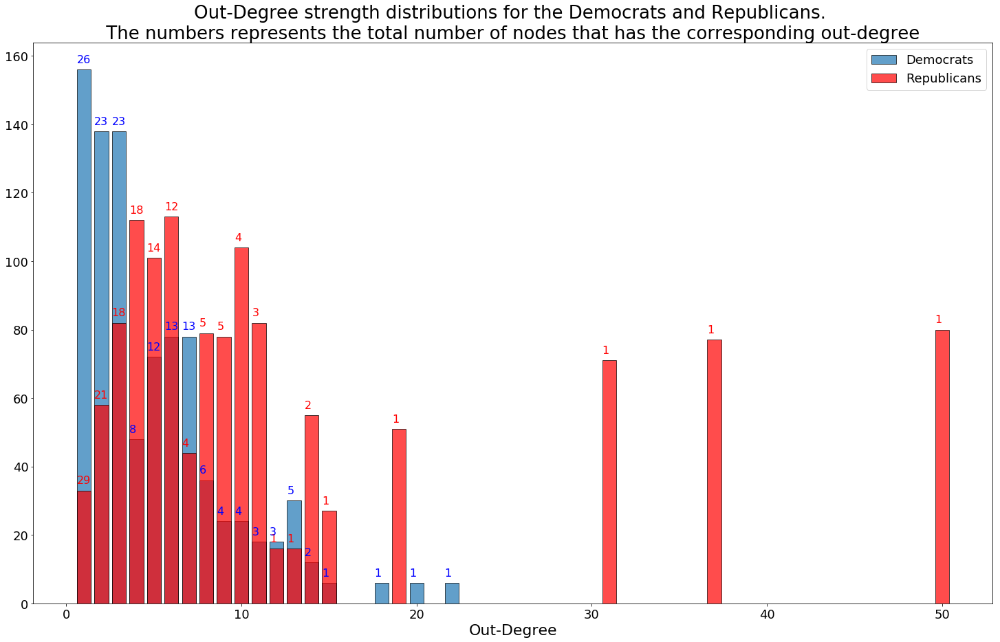

Total number of retweets by Democrats: 894
Total number of retweets by Republicans: 1279


In [129]:
# To be used for plotting
rep_deg_out_freq = []
dem_deg_out_freq = []
for rep in rep_members:
    rep_deg_out_freq.append(twitter_graph.out_degree(rep))
    
for dem in dem_members:
    dem_deg_out_freq.append(twitter_graph.out_degree(dem))

rep_deg_count = np.bincount(rep_deg_out_freq)
dem_deg_count = np.bincount(dem_deg_out_freq)



plt.figure(figsize=(25,15))
plt.bar(out_deg_dem.keys(), out_deg_dem.values(), edgecolor='black', alpha = 0.7, label='Democrats')
plt.bar(out_deg_rep.keys(), out_deg_rep.values(), edgecolor='black', alpha = 0.7, label='Republicans', color='red')

for i, count in enumerate(rep_deg_count):
    if i in out_deg_rep:
        plt.annotate(str(count), xy=(i-0.4, out_deg_rep[i]+2), fontsize = 16, color = 'red')
    
for i, count in enumerate(dem_deg_count):
    if i in out_deg_dem:
        plt.annotate(str(count), xy=(i-0.4, out_deg_dem[i]+2), fontsize = 16, color = 'blue')
    
    
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.xlabel('Out-Degree', fontsize=22)
plt.legend(fontsize=18)
plt.title('''Out-Degree strength distributions for the Democrats and Republicans. \n The numbers represents the total number of nodes that has the corresponding out-degree ''', fontsize=26)
plt.show()
print(f'Total number of retweets by Democrats: {sum(out_deg_dem.values())}')
print(f'Total number of retweets by Republicans: {sum(out_deg_rep.values())}')

#### Find the 3 members of the republican party that have retweeted tweets from democratic members most often. Repeat the measure for the democratic members. Can you explain your results by looking at the Wikipedia pages of these members of the house?

**Answer**

>Looking at Gene Green's wikipedia page one can find that he has been a member of a couple of committees. During the 115th Congress, you can see that in all committees he was a part of, the majority was republicans. That might explain why he tweeted many republicans as he worked with a lot of them. 
For Brian Fitzpatrick one can find that he seems to support some of the democratic ideals which can explain why he might have retweeted a lot of democrats. For example "He was the only Republican Congressman from Pennsylvania who did not take part in a February 2018 lawsuit challenging a new district map drawn by Democrats" (From his wikipedia page). This is one of many cases that shows his leniency towards democrats.

In [130]:
rep_to_dem_tweets = {}
for rep in rep_members:
    rep_links = dict(twitter_graph[rep])
    rep_to_dem_tweets[rep] = 0
    for link in rep_links:
        if link in dem_members: 
            rep_to_dem_tweets[rep] += rep_links[link]['weight']
        else:
            continue
dem_to_rep_tweets = {}
for dem in dem_members:
    dem_links = dict(twitter_graph[dem])
    dem_to_rep_tweets[dem] = 0
    for link in dem_links:
        if link in rep_members: 
            dem_to_rep_tweets[dem] += dem_links[link]['weight']
        else:
            continue

highest_n = 3
for i, info in enumerate((sorted(dem_to_rep_tweets.items(), key = lambda x: x[1])[-highest_n:])):
    name = info[0]
    nr_retweets = info[1]
    print(f'The {highest_n-i} highest democrat who has retweeted republicans: {name} with {nr_retweets} retweets')

print()
for i, info in enumerate((sorted(rep_to_dem_tweets.items(), key = lambda x: x[1])[-highest_n:])):
    name = info[0]
    nr_retweets = info[1]
    print(f'The {highest_n-i} highest republican who has retweeted democrats: {name} with {nr_retweets} retweets')

The 3 highest democrat who has retweeted republicans: Ted Deutch with 5 retweets
The 2 highest democrat who has retweeted republicans: Cedric Richmond with 5 retweets
The 1 highest democrat who has retweeted republicans: Gene Green with 9 retweets

The 3 highest republican who has retweeted democrats: Tom Reed with 4 retweets
The 2 highest republican who has retweeted democrats: Francis Rooney with 5 retweets
The 1 highest republican who has retweeted democrats: Brian Fitzpatrick with 10 retweets


## _Exercise_ 3: Community detection.

* Use your favorite method of community detection to find communities in the full house of representatives network. Report the value of modularity found by the algorithm. Is it higher or lower than what you found for the Wikipedia network (Week 7)? Comment on your result.

**Answer**
>It seems that the found modularity for the twitter network is slightly larger than the one found in the wikipedia network. We remind ourself that modularity measures the density of the connection within their communities where a high modularity means a more dense connection. Returning to the argument that twitter is a platform where you're able to express your thoughts and views on topics with limited amount of space, it should not come as a surprise that the democrats and republicans tends to retweet their fellow party members more than their counterpart.

In [132]:
from community import best_partition, modularity

coms = best_partition(nx.Graph(twitter_graph))
com_ids = np.array(list(coms.values()))
print('The modularity of the network:', round(modularity(coms, nx.Graph(twitter_graph)), 5))

The modularity of the network: 0.48464


* Visualize the network, using the Force Atlas algorithm. This time assign each node a different color based on their *community*. Describe the structure you observe.

**Answer**
>Looking at the graph, we can notice that the majority of the democrats and republicans have been placed in their own community respectively (purple for most democrats and blue for most republicans). We can also observe some members within the democratic and republican party have formed communities within themselves as observed by looking at community with id 6 and 8 (These are mostly appearing at the republican side). These "within" communities might also include members from both the democratic and republican parties though.

100%|██████████| 400/400 [00:01<00:00, 388.79it/s]


BarnesHut Approximation  took  0.38  seconds
Repulsion forces  took  0.58  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.03  seconds


(-439387.66546211764,
 439251.3057178501,
 -54882.213352865314,
 54198.628401088754)

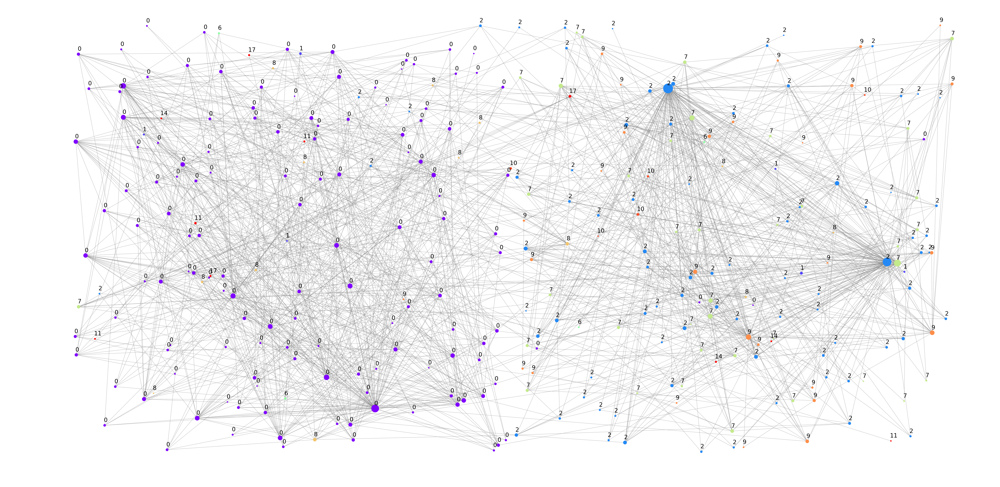

In [133]:
from matplotlib import cm
color_map = []

for com_id in com_ids:
    color_map.append(cm.rainbow(com_id*max(com_ids))[:3])

undir_tw_G = nx.Graph(twitter_graph)
force_atlas2 = ForceAtlas2()
positions = force_atlas2.forceatlas2_networkx_layout(undir_tw_G, pos=None, iterations=400)

for idx, key in enumerate(positions):
    if 'Democratic' == h115_tw['Party'][idx]:
        positions[key] = (positions[key][0] - np.random.randint(100,400000), positions[key][1] + np.random.randint(-50000,50000))
    else:
        positions[key] = (positions[key][0] + np.random.randint(100,400000), positions[key][1]+ np.random.randint(-50000,50000))

plt.figure(figsize=(30,15), dpi=200)
nx.draw_networkx_nodes(undir_tw_G, pos=positions, node_color = color_map, 
                       node_size = [2*v for v in dict(twitter_graph.degree()).values()])

nx.draw_networkx_edges(undir_tw_G, pos=positions, edge_color= 'grey', width = 0.25 )

# annotate the community id to each node
for key in positions:
    if twitter_graph.degree(key) == 0:
        continue
    com_id = coms[key]
    x, y = positions[key]
    plt.annotate(str(com_id), (x-800, y+800))

plt.axis('off')

* Compare the communities found by your algorithm with the parties by creating a matrix $\mathbf{D}$ with dimension $(B \times C$, where $B$ is the number of parties and $C$ is the number of communities. We set entry $D(i,j)$ to be the number of nodes that party $i$ has in common with community $j$. The matrix $\mathbf{D}$ is what we call a [**confusion matrix**](https://en.wikipedia.org/wiki/Confusion_matrix).

In [134]:
conf_mat = np.zeros((2, max(com_ids)), dtype = int)

for i in range(0, max(com_ids)):
    
    member_list = [person for person, com_id in coms.items() if com_id == i]
    
    rep_list = [rep_person for rep_person in member_list if h115_tw[h115_tw['Name'] == rep_person]['Party'].item() == 'Republican']
    dem_list = [dem_person for dem_person in member_list  if h115_tw[h115_tw['Name'] == dem_person]['Party'].item() == 'Democratic']
    conf_mat[0, i] = len(rep_list)
    conf_mat[1, i] = len(dem_list)
print('Rows are community id and columns represents Republican and Democratic respectively when we transpose D.')
conf_mat.T

Rows are community id and columns represents Republican and Democratic respectively when we transpose D.


array([[  4, 133],
       [  3,   3],
       [ 77,   5],
       [  1,   0],
       [  0,   1],
       [  0,   1],
       [  2,   2],
       [ 37,   1],
       [  4,   9],
       [ 27,   1],
       [  4,   1],
       [  1,   3],
       [  1,   0],
       [  1,   0],
       [  2,   1],
       [  0,   1],
       [  0,   1],
       [  1,   2],
       [  1,   0],
       [  1,   0],
       [  0,   1],
       [  0,   1],
       [  1,   0]])

* Use the confusion matrix to explain how well the communities you've detected correspond to the parties. Consider the following questions
  * Are there any republicans grouped with democrats (and vice versa)?
  * Does the community detection algorithm sub-divide the parties? Do you know anything about American politics that could explain such sub-divisions? Answer in your own words.
  
**Answer**

>Looking at the confusion matrix we can see that the majority of the democrats has been grouped into community 0 and the majority of republicans into community 2. As mentioned earlier we noticed that some sub-communities could be seen on the last graph we plotted and this becomes more clear as well if we look at just how many are in community 6, 7 and 8. However in community 6, we have almost the same number of democrats and republicans in that community. Looking at the graph we can see that the democratic members of that community tends to somewhat lie on the seperation between democrats and republicans. As we are not really experts in American politics we dont really have a solid justification on why this is, but it might due to the those members are related in some kind of sense (might be from neighbor states, same states or even working in the same committees as we saw with Gene Green).

# Part 2: What do republican and democratic members tweet about?

_Exercise_ 4: TF-IDF of the republican and democratic tweets.

We will create two documents, one containing the words extracted from tweets of republican members, and the other for Democratic members. We will then use TF-IDF to compare the content of these two documents and create a word-cloud. The procedure you should use is exactly the same you used in exercise 2 of week 7. The main steps are summarized below: 
* Create two large documents, one for the democratic and one for the republican party. Tokenize the pages, and combine the tokens into one long list including all the pages of the members of the same party. 
  * Exclude the twitter handles of other members.
  * Exclude punctuation.
  * Exclude stop words (if you don't know what stop words are, go back and read NLPP1e again).
  * Exclude numbers (since they're difficult to interpret in the word cloud).
  * Set everything to lower case.
  * Compute the TF-IDF for each document.
* Now, create word-cloud for each party. Are these topics less "boring" than the Wikipedia topics from Week 7? Why?  Comment on the results.

In [102]:
import io
import pandas as pd
import networkx as nx
import nltk
from nltk.corpus import stopwords
import string
import unicodedata
import os.path
from nltk import word_tokenize
import math
from wordcloud import WordCloud

In [103]:
df = pd.read_csv('./H115_tw_2019.csv')

names = []
regx_list = ['@\w*', 'RT', '(http|https):\/\/\w*.\w*\/\w*', '\d']

for member in range(len(df)):
    name = df['WikiPageName'][member]
    name = unicodedata.normalize('NFD', name).encode('ascii', 'ignore')
    names.append(name)
    path = './tweets_2019_full/' + name.decode('utf-8')
    # Checking if path exists
    if os.path.exists(path):
        with io.open(path, 'r', encoding='utf-8') as f:
            # Reading the file
            blee = f.read()
            #Taking out the things we want to avoid (numbers, mentions, sites)
            for regx in regx_list:
                blee = re.sub(regx, '', blee)
            blee.lower()
            if (len(blee) < 1):
                continue
            # Putting the text in a text file based on the Party
            if(df['Party'][member] == "Republican"):
                with io.open('./Republican.txt', 'a+', encoding='utf-8') as t:
                    t.write(blee)
                    t.close()
            else:
                with io.open('./Democrat.txt', 'a+', encoding='utf-8') as t:
                    t.write(blee)
                    t.close()
            f.close()

## Create two large documents, one for the democratic and one for the republican party. Tokenize the pages, and combine the tokens into one long list including all the pages of the members of the same party.

In [106]:
stopWords = set(stopwords.words('english'))

demo = open('./Democrat.txt').read()
demtokens = word_tokenize(demo)
demtokens=[word.lower() for word in demtokens if word.isalpha()]
demtoken = []
# Removing stop words
for w in demtokens:
    if w not in stopWords and w not in names:
        demtoken.append(w)

repub = open('./Republican.txt').read()
reptokens = word_tokenize(repub)
reptokens=[word.lower() for word in reptokens if word.isalpha()]
reptoken = []
# Removing stop words
for w in reptokens:
    if w not in stopWords and w not in names:
        reptoken.append(w)

In [107]:
# Creating the two frequency distributions for republican and democrat
from nltk.probability import FreqDist
demodist = FreqDist(demtoken)
repubdist = FreqDist(reptoken)
print(demodist.most_common(5))
print(repubdist.most_common(5))

[('amp', 16966), ('today', 9278), ('trump', 9144), ('president', 6954), ('house', 6110)]
[('amp', 15692), ('today', 9542), ('house', 6672), ('great', 6498), ('american', 5290)]


## Compute the TF-IDF for each document.

In [108]:
#Calculating TF
Dtf = [(i[0], float(i[1]) / float(len(demtokens))) for i in demodist.most_common(len(demodist))]
Rtf = [(i[0], float(i[1]) / float(len(reptokens))) for i in repubdist.most_common(len(repubdist))]

#The 5 words for each party with highest TF
print(Dtf[:5])
print(Rtf[:5])

[('amp', 0.007759787778997438), ('today', 0.004243505305525064), ('trump', 0.004182217343578485), ('president', 0.0031805708013172337), ('house', 0.0027945481156238564)]
[('amp', 0.00739371882571235), ('today', 0.004495976614513589), ('house', 0.0031436969159541676), ('great', 0.003061712014369032), ('american', 0.002492529479226251)]


In [109]:
#Calculating IDF
Didf = [(i[0], math.log(len(demtokens) / int(i[1]))) for i in demodist.most_common(len(demodist))]
Ridf = [(i[0], math.log(len(reptokens) / int(i[1]))) for i in repubdist.most_common(len(repubdist))]

#The 5 words for each party with highest IDF
print(Didf[:5])
print(Ridf[:5])

[('amp', 4.858800293228315), ('today', 5.4623656282843065), ('trump', 5.476913708121349), ('president', 5.750694601028188), ('house', 5.880084861430355)]
[('amp', 4.907124446549107), ('today', 5.404572367802498), ('house', 5.762355809839967), ('great', 5.788781037649504), ('american', 5.994457229026205)]


In [111]:
Dtf_dict = dict(Dtf)
Rtf_dict = dict(Rtf)
Didf_dict = dict(Didf)
Ridf_dict = dict(Ridf)

In [112]:
def tfidf_top (tf, idf):
    tfidf = []
    for k in tf:
        tfidf.append((k, (tf[k] * idf[k])))
    print(tfidf[:5])

In [113]:
print("Democrats Top 5 TF-IDF:")
tfidf_top(Dtf_dict, Didf_dict)
print("Republicans Top 5 TF-IDF:")
tfidf_top(Rtf_dict, Ridf_dict)

Democrats Top 5 TF-IDF:
[('amp', 0.03770325913598225), ('today', 0.023179577524342205), ('trump', 0.02290564349938786), ('president', 0.018290491335322914), ('house', 0.016432180069218563)]
Republicans Top 5 TF-IDF:
[('amp', 0.03628189840056342), ('today', 0.024298830977086364), ('house', 0.018115100188024483), ('great', 0.017723580451523117), ('american', 0.014941361355308722)]


## Now, create word-cloud for each party. 

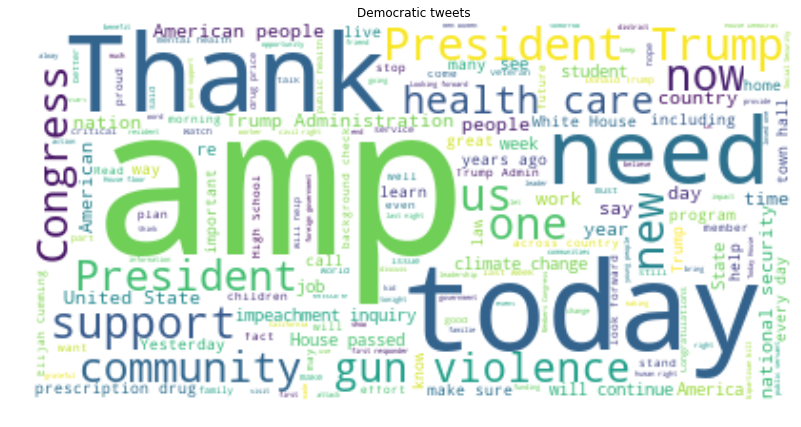

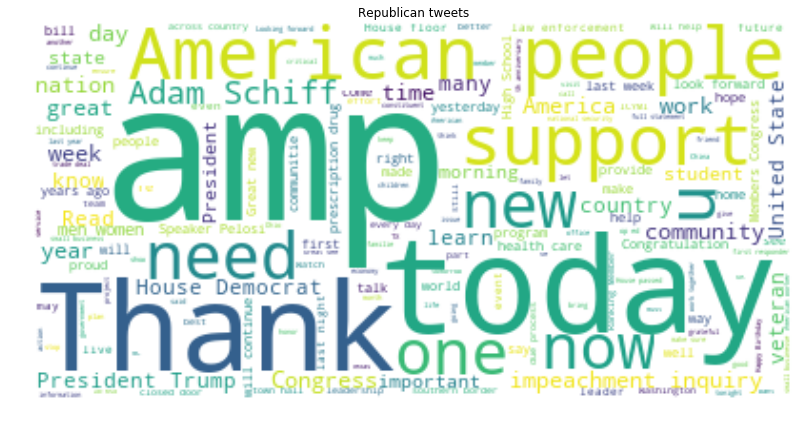

In [114]:
#Creating word-cloud for each party
wordcloud = WordCloud(background_color='white').generate(demo)
plt.figure(figsize=(15, 7)) 
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Democratic tweets')
plt.axis("off")
plt.show()     

wordcloud = WordCloud(background_color='white').generate(repub)
plt.figure(figsize=(15, 7)) 
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Republican tweets')
plt.axis("off")
plt.show()

**Question:** Are these topics less "boring" than the Wikipedia topics from Week 7? Why?

**Answer:** These are more interesting than the Wikipedia topics because it's more personal. On the Wikipedia, the article is written by someone else in a rather arbitrary fashion, but with the tweets we see what they have to say for themselves. Their tweets show their personality and what they have to say.

# Part 3: Sentiment analysis

_Exercise_ 5: Sentiment over the Twitter data.

* Download the LabMT wordlist. It's available as supplementary material from [Temporal Patterns of Happiness and Information in a Global Social Network: Hedonometrics and Twitter](http://journals.plos.org/plosone/article?id=10.1371/journal.pone.0026752) (Data Set S1). Describe briefly how the list was generated.
* Based on the LabMT word list, write a function that calculates sentiment given a list of tokens (the tokens should be lower case, etc).
* Create two lists: one containing tweets by democratic members, and the other with the tweets of republican members. Calculate the sentiment of each tweet and plot the distribution of sentiment for each of the two lists. Are there significant differences between the two? Which party post more positive tweets?
* Compute the average $m$ and standard deviation $\sigma$  of the Tweets sentiment (considering tweets by both republican and democrats). 
* Now only tweets with sentiment lower than $m-2\sigma$. We will refer to them as *negative* tweets.  Build a list containing *negative* tweets written by democrats, and one for republicans. Compute the TF-IDF on these two lists. Create a word-cloud for each of them. Are there differences between the positive content posted by republican and democrats?
* Repeat the point above, but considering _positive_ tweets (e.g. with sentiment larger than $m+2\sigma$). Comment on your results.


## Here we are downloading the LambMT wordlist.

**Question:** (Data Set S1). Describe briefly how the list was generated.

**Answer:** It was generated based on the output given by people hired at Amazon's Mechanical Turk platform (where people do simple tasks, which cannot be done automatically, for money; e.g. labelling words in text).

In [6]:
import urllib

url = 'https://journals.plos.org/plosone/article/file?id=10.1371/journal.pone.0026752.s001&type=supplementary'
df_sentiment = pd.read_csv(url, skiprows=2, header=None, sep='\t')

# need to set the column names and remove the first row
df_sentiment.columns = df_sentiment.iloc[0]
df_sentiment = df_sentiment.drop(df_sentiment.index[0]).reset_index()
df_sentiment = df_sentiment.drop(['index'], axis=1)
df_sentiment[['happiness_rank', 'happiness_average', 'happiness_standard_deviation']] = \
df_sentiment[['happiness_rank', 'happiness_average', 'happiness_standard_deviation']].apply(pd.to_numeric)
df_sentiment.head()

,word,happiness_rank,happiness_average,happiness_standard_deviation,twitter_rank,google_rank,nyt_rank,lyrics_rank
0,laughter,1,8.50,0.9313,3600,--,--,1728
1,happiness,2,8.44,0.9723,1853,2458,--,1230
2,love,3,8.42,1.1082,25,317,328,23
3,happy,4,8.30,0.9949,65,1372,1313,375
4,laughed,5,8.26,1.1572,3334,3542,--,2332


In [7]:
from nltk.corpus import stopwords
from string import punctuation


stopwords = stopwords.words('english')

## Based on the LabMT word list, write a function that calculates sentiment given a list of tokens (the tokens should be lower case, etc).

In [8]:
def get_processed_tokens(text):
    # remove urls and digits from the text, change to lowercase
    text = re.sub(r'\d+', '', text.lower())
    text = re.sub(r'@\w*|https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+[\/\w+]*', '', text)
    
    tokens = nltk.word_tokenize(text)
    # excluding numbers, names, stop words respectively
    
    # remove punctuation
    processed = [''.join(c for c in word if c not in punctuation) for word in tokens]
    # remove empty words
    processed = [word for word in processed if len(word) > 1]
    # remove stop words
    processed = [word for word in processed if word not in stopwords]
    
    return processed


def calculate_token_list_sentiment(tokens):
    no_words_labeled = len(tokens)
    happines_sum = 0
    
    word_count = 0
    for word in tokens:
        #try:  
        if word in list(df_sentiment['word']):
            word_count += 1
            happines_sum += df_sentiment[df_sentiment['word'] == word]['happiness_average'].item()
        #print(word)
        #print(word_happiness.item())
            
        #except:
        #    no_words_labeled +=1  
    
    if word_count == 0:
        return -1
    return happines_sum / word_count

In [9]:
test_1 = 'Look at happy little trees. So much fun. I love life.'
calculate_token_list_sentiment(get_processed_tokens(test_1))

6.8575

In [10]:
test_2 = 'Blood, suicide, sadness. I want to cut myself, see you at the funeral. Bring some alcohol and drugs'
calculate_token_list_sentiment(get_processed_tokens(test_2))

3.7439999999999998

In [11]:
test_3 = "Gustaw Laura Mark Stephano"
calculate_token_list_sentiment(get_processed_tokens(test_3))

5.53

## Create two lists: one containing tweets by democratic members, and the other with the tweets of republican members.

In [22]:
import os 
import re 

# tweet directory
path = "./tweets_2019_full"

# get data about the politician names, their wiki pages, party and more info
h115_csv_path = './H115_tw_2019.csv'
df_h115 = pd.read_csv(h115_csv_path)

df_h115.head()

,WikiPageName,Party,State,Name,tw_id,tw_name
0,Don_Young,Republican,Alaska,Don Young,3.700727e+07,repdonyoung
1,Jim_Sensenbrenner,Republican,Wisconsin,Jim Sensenbrenner,8.516214e+08,JimPressOffice
2,Hal_Rogers,Republican,Kentucky,Hal Rogers,5.504018e+08,RepHalRogers
3,Chris_Smith_(New_Jersey_politician),Republican,New Jersey,Chris Smith,1.289319e+09,RepChrisSmith
4,Steny_Hoyer,Democratic,Maryland,Steny Hoyer,2.201209e+07,LeaderHoyer


In [23]:
democrats = {}
republicans = {}

for file in os.listdir(path):
    wiki_name = file
    persons_tweets = open(path + '/' + file, encoding= 'utf-8').read()  
    persons_tweets = re.sub(r'\d+', '', persons_tweets.lower())
    persons_tweets = re.sub(r'@\w*|https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+[\/\w+]*', '', persons_tweets)
    
    persons_tweets_list = list(filter(None, persons_tweets.splitlines())) # a list of seperated tweets

    final_tweet_list = []
    for tweet in persons_tweets_list:
        tokens = nltk.word_tokenize(tweet)
        # excluding numbers, names, stop words respectively

        # remove punctuation
        tokens = [''.join(c for c in word if c not in punctuation) for word in tokens]
        # remove empty words
        tokens = [word for word in tokens if len(word) > 1]
        # remove stop words
        tokens = [word for word in tokens if word not in stopwords]

        final_tweet_list.append(' '.join(tokens))
    persons_df_record = df_h115[df_h115['WikiPageName'] == wiki_name] 
    persons_name = persons_df_record['Name'].item()
    persons_party = persons_df_record['Party'].item()
    persons_handle = persons_df_record['tw_name'].item()
    
    handles = re.findall("RT\s\@\w+\:", persons_tweets)
    handle_list = []
    for handle in handles:
        handle_list.append(handle.split("@")[1].split(":")[0])
        
    dict_item =  { 
        "name" : persons_name,
        "wikiname": wiki_name,
        "handle": persons_handle,
        "tweets": final_tweet_list
    }
    if persons_party == 'Democratic':
        democrats[wiki_name] = dict_item
    else: 
        republicans[wiki_name] = dict_item

In [24]:
def get_tweets_list(party_dict):
    tweet_list = []
    
    for key, value in party_dict.items():
        all_tweets = value["tweets"] # a string with all tweets separated by new line
        tweet_list.extend(all_tweets)    
    
    return tweet_list

In [25]:
democrats_tweets = get_tweets_list(democrats)
republicans_tweets = get_tweets_list(republicans)

## Calculate the sentiment of each tweet and plot the distribution of sentiment for each of the two lists.

In [26]:
democrats_tweets_tokens = [get_processed_tokens(x) for x in democrats_tweets]
republicans_tweets_tokens = [get_processed_tokens(x) for x in republicans_tweets]

In [27]:
import time
from IPython.display import clear_output

def get_group_tweets_sentiments(group_tweets_tokens):
    group_tweets_sentiments = []
    for i in range(len(group_tweets_tokens)):        
        tweet_sentiment = calculate_token_list_sentiment(group_tweets_tokens[i])
        #if tweet_sentiment != -1:
        group_tweets_sentiments.append(tweet_sentiment)
        
        if (i+1) % round(0.01 * len(group_tweets_tokens)) == 0:
            clear_output(wait=True)
            current_percent = (i+1) / round(0.01 * len(group_tweets_tokens))
            print(f"{current_percent}% done.")
    return group_tweets_sentiments

In [28]:
democrats_tweets_sentiments = get_group_tweets_sentiments(democrats_tweets_tokens)

100.0% done.


In [29]:
republicans_tweets_sentiments = get_group_tweets_sentiments(republicans_tweets_tokens)

99.0% done.


## Plot the distribution of sentiment for each of the two lists

In [31]:
def plot_sentiment_distribution():
    plt.figure(figsize=(15,5))
    
    bins = np.linspace(0, np.max([np.max(democrats_tweets_sentiments), 
                                 np.max(republicans_tweets_sentiments)]))
    plt.hist([republicans_tweets_sentiments, democrats_tweets_sentiments], bins, label=['Republican', 'Democrat'])
    
    plt.legend(loc='upper right')
    plt.title('Distribution of sentiment')
    plt.xlabel('Sentiment score')
    plt.ylabel('# of tweets')
    plt.show()

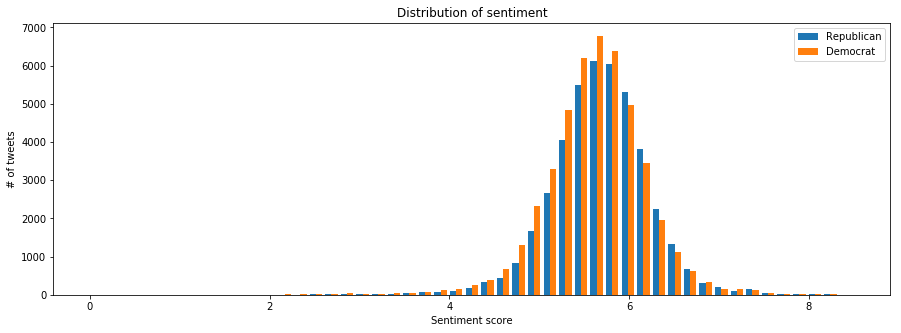

In [32]:
plot_sentiment_distribution()

**Questions:** 
1. Are there significant differences between the two? 
2. Which party post more positive tweets?

**Answers:**
1. Not really, the distribution looks very similar. Based on the fact that there are fewer republican tweets  and that there are more positive tweets from the republicans means that their tweets are more positive.
2. Republicans.

## Compute the average  𝑚  and standard deviation  𝜎  of the Tweets sentiment (considering tweets by both republican and democrats).

In [33]:
len(democrats_tweets_sentiments)

49613

In [34]:
all_tweets_sentiments = democrats_tweets_sentiments + republicans_tweets_sentiments

In [35]:
all_tweets_sentiments[1]

5.373333333333335

In [36]:
def compute_and_print_mean_and_std(sentiment_list):
    sentiment_list_without_negative_values = [x for x in sentiment_list if x >= 0]
    m = np.mean(sentiment_list_without_negative_values)
    sigma = np.std(sentiment_list_without_negative_values)
    print(f"Average m: {m}")
    print(f"Standard deviation sigma: {sigma}")
    return m, sigma

In [37]:
m_democrats, sigma_democrats = compute_and_print_mean_and_std(democrats_tweets_sentiments)

Average m: 5.613178375834671
Standard deviation sigma: 0.5658719398927641


In [38]:
m_republicans, sigma_republicans = compute_and_print_mean_and_std(republicans_tweets_sentiments)

Average m: 5.688344559705174
Standard deviation sigma: 0.5492334593233364


## Now only tweets with sentiment lower than  𝑚−2𝜎 . We will refer to them as negative tweets. Build a list containing negative tweets written by democrats, and one for republicans. 

In [39]:
len(republicans_tweets) == len(republicans_tweets_sentiments)

True

In [91]:
def get_selected_tweets(list_of_tweets, list_of_tweets_sentiments, m, sigma, which_ones):
    result_list = []
    result_string = ""

    if which_ones == 'negative':
        border_value = m - 2 * sigma
        for i in range(len(list_of_tweets_sentiments)):        
            if list_of_tweets_sentiments[i] < border_value and list_of_tweets_sentiments != -1:
                result_list.append(list_of_tweets[i])
                result_string = result_string + list_of_tweets[i]
    else:
        border_value = m + 2 * sigma
        for i in range(len(list_of_tweets_sentiments)):        
            if list_of_tweets_sentiments[i] > border_value and list_of_tweets_sentiments != -1:
                result_list.append(list_of_tweets[i])
                result_string = result_string + list_of_tweets[i]
    
    return result_list, result_string

In [92]:
republicans_negative_tweets, republicans_negaive_string = get_selected_tweets(republicans_tweets, republicans_tweets_sentiments, 
                                                  m_republicans, sigma_republicans, 'negative')
democrats_negative_tweets, democrats_negative_string = get_selected_tweets(democrats_tweets, democrats_tweets_sentiments,
                                               m_democrats, sigma_democrats, 'negative')

## Compute the TF-IDF on these two lists.

In [42]:
democrats_negative_tweets_tokens = nltk.word_tokenize(''.join(democrats_negative_tweets))
republicans_negative_tweets_tokens = nltk.word_tokenize(''.join(republicans_negative_tweets))

In [43]:
from nltk.probability import FreqDist

democrats_negative_distribution = FreqDist(democrats_negative_tweets_tokens) 
republicans_negative_distribution = FreqDist(republicans_negative_tweets_tokens) 

curious **TODO:** check if equations from https://en.wikipedia.org/wiki/Tf%E2%80%93idf return the same

In [75]:
Dtf_negative = [(i[0], float(i[1]) / float(len(democrats_negative_tweets_tokens))) 
                for i in democrats_negative_distribution.most_common(len(democrats_negative_distribution))]
Rtf_negative = [(i[0], float(i[1]) / float(len(republicans_negative_tweets_tokens))) 
                for i in republicans_negative_distribution.most_common(len(republicans_negative_distribution))]

In [76]:
Didf_negaitve = [(i[0], math.log(len(democrats_negative_tweets_tokens) / int(i[1]))) for i in democrats_negative_distribution.most_common(len(democrats_negative_distribution))]
Ridf_negative = [(i[0], math.log(len(republicans_negative_tweets_tokens) / int(i[1]))) for i in republicans_negative_distribution.most_common(len(republicans_negative_distribution))]

In [77]:
Dtf_negative_dict = dict(Dtf_negative)
Rtf_negative_dict = dict(Rtf_negative)
Didf_negaitve_dict = dict(Didf_negaitve)
Ridf_negative_dict = dict(Ridf_negative)

In [81]:
print("Democrats Top 5 Negative TF-IDF:")
tfidf_top(Dtf_negative_dict, Didf_negaitve_dict)
print("Republicans Top 5 Negative TF-IDF:")
tfidf_top(Rtf_negative_dict, Ridf_negative_dict)

Democrats Top 5 Negative TF-IDF:
[('gun', 0.0668609832974029), ('violence', 0.06275660625956665), ('trump', 0.030036768541112955), ('must', 0.0293623717915754), ('never', 0.0293623717915754)]
Republicans Top 5 Negative TF-IDF:
[('bill', 0.04376777093071891), ('unemployment', 0.04086797710736545), ('drug', 0.03789708462278712), ('rate', 0.029784062619769857), ('amp', 0.029133159036965502)]


## Create a word-cloud for each of them.

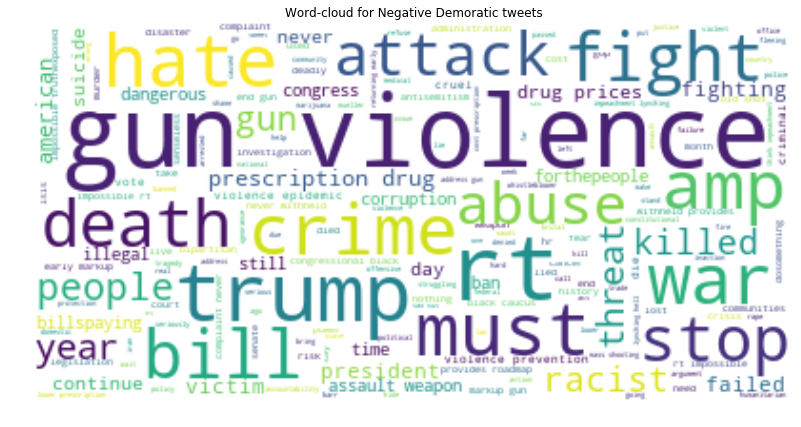

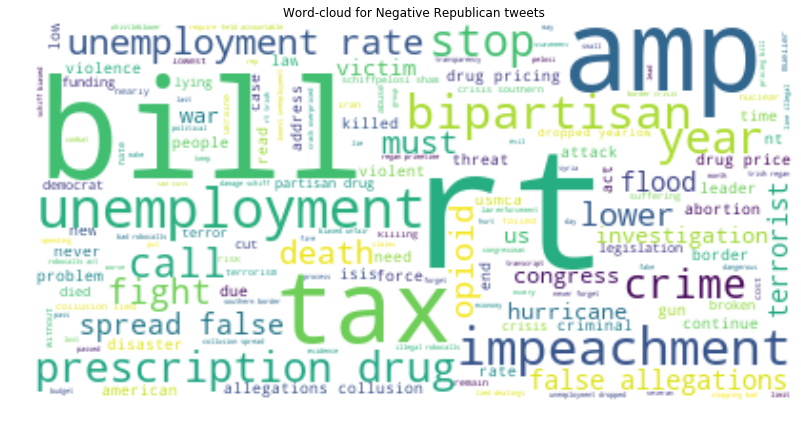

In [94]:
wordcloud = WordCloud(background_color='white').generate(democrats_negative_string)
plt.figure(figsize=(15, 7)) 
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word-cloud for Negative Demoratic tweets')
plt.axis("off")
plt.show() 

wordcloud = WordCloud(background_color='white').generate(republicans_negaive_string)
plt.figure(figsize=(15, 7)) 
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word-cloud for Negative Republican tweets')
plt.axis("off")
plt.show()

**Question:** Are there differences between the negative content posted by republican and democrats?

**Answer:** Yes. In the Republican's we see a lot about bills, tax, impeachment. In Democrat's we see gun, violence, and hate. The Republican's negative posts seem to have a lot to do with government or money, while democrat's have to do with more social problems. 

## Repeat the point above, but considering *positive* tweets (e.g. with sentiment larger than $m+2\sigma$). Comment on your results.

In [95]:
republicans_positive_tweets, republicans_positive_string = get_selected_tweets(republicans_tweets, republicans_tweets_sentiments, 
                                                  m_republicans, sigma_republicans, 'positive')
democrats_positive_tweets, democrats_positive_string = get_selected_tweets(democrats_tweets, democrats_tweets_sentiments,
                                               m_democrats, sigma_democrats, 'positive')

In [97]:
democrats_positive_tweets_tokens = nltk.word_tokenize(''.join(democrats_positive_tweets))
republicans_positive_tweets_tokens = nltk.word_tokenize(''.join(republicans_positive_tweets))

In [98]:
democrats_positive_distribution = FreqDist(democrats_positive_tweets_tokens) 
republicans_positive_distribution = FreqDist(republicans_positive_tweets_tokens) 

Dtf_positive = [(i[0], float(i[1]) / float(len(democrats_positive_tweets_tokens))) 
                for i in democrats_positive_distribution.most_common(len(democrats_positive_distribution))]
Rtf_positive = [(i[0], float(i[1]) / float(len(republicans_positive_tweets_tokens))) 
                for i in republicans_positive_distribution.most_common(len(republicans_positive_distribution))]

Didf_positive = [(i[0], math.log(len(democrats_positive_tweets_tokens) / int(i[1]))) for i in democrats_positive_distribution.most_common(len(democrats_positive_distribution))]
Ridf_positive = [(i[0], math.log(len(republicans_positive_tweets_tokens) / int(i[1]))) for i in republicans_positive_distribution.most_common(len(republicans_positive_distribution))]

In [99]:
Dtf_positive_dict = dict(Dtf_positive)
Rtf_positive_dict = dict(Rtf_positive)
Didf_positive_dict = dict(Didf_positive)
Ridf_positive_dict = dict(Ridf_positive)

print("Democrats Top 5 Positive TF-IDF:")
tfidf_top(Dtf_positive_dict, Didf_positive_dict)
print("Republicans Top 5 Positive TF-IDF:")
tfidf_top(Rtf_positive_dict, Ridf_positive_dict)

Democrats Top 5 Positive TF-IDF:
[('happy', 0.08122715451248058), ('celebrating', 0.06943666906893808), ('family', 0.0557573463896314), ('new', 0.0557573463896314), ('year', 0.0448367741964655)]
Republicans Top 5 Positive TF-IDF:
[('day', 0.08407166321860196), ('great', 0.0772315194491751), ('happy', 0.07459376563683594), ('birthday', 0.0737051578501276), ('family', 0.05378995819185834)]


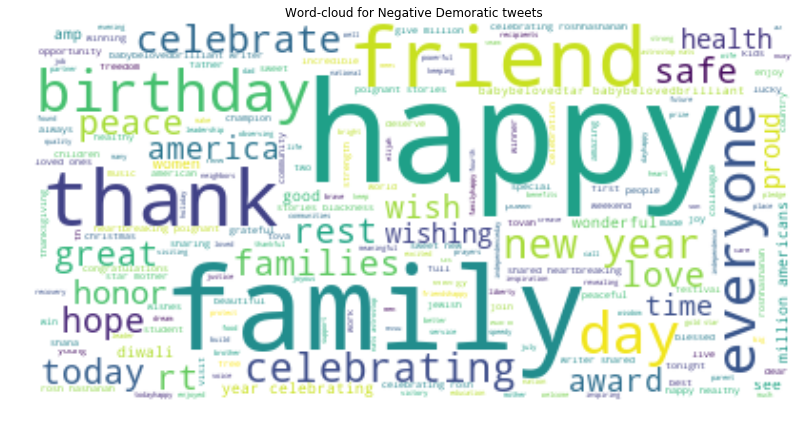

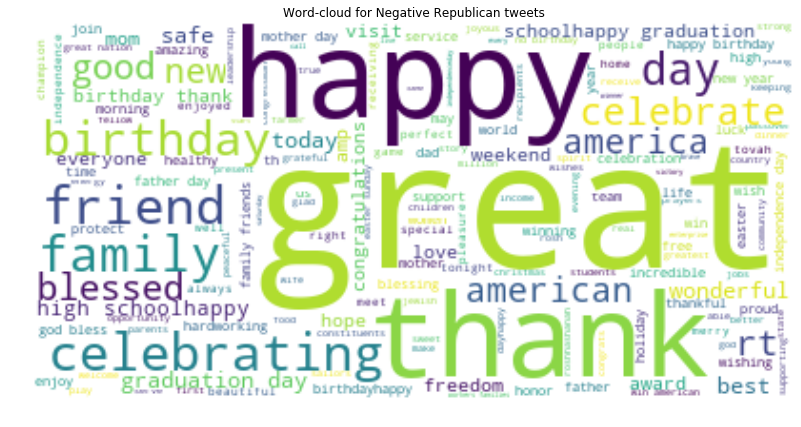

In [96]:
wordcloud = WordCloud(background_color='white').generate(democrats_positive_string)
plt.figure(figsize=(15, 7)) 
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word-cloud for Negative Demoratic tweets')
plt.axis("off")
plt.show() 

wordcloud = WordCloud(background_color='white').generate(republicans_positive_string)
plt.figure(figsize=(15, 7)) 
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word-cloud for Negative Republican tweets')
plt.axis("off")
plt.show()

**Question:** Are there differences between the positive content posted by republican and democrats?

**Answer:** There are more similarities in the positive tweets. Both have 'happy' and 'thank' as pretty large words. There are small differences, but overall the positive ones are very close.